In [1]:
from pathlib import Path
import Bio
from Bio.PDB import PDBList
import shutil
from Bio.PDB import PDBParser
import mdtraj
from Bio.Align.Applications import ClustalOmegaCommandline
import subprocess
import biotite.sequence as seq
import biotite.sequence.graphics as graphics
from Bio import SeqIO
import matplotlib.pyplot as plt
from os import path, system

# Workflow 1 - extract features from the PDB files

**Input:** reference PDB and trajectory


**Output:** featurized trajectory
<hr>
Steps:

1. Load reference PDB and trajectory in the EnGen object
3. Provide set of featurizations of interest (or use default)
4. Evaluate different featurization (optional)
5. Choose the best featurization
6. Extract those features

In [2]:
# required imports 
from engens.core.EnGens import *
import engens.core.FeatureSelector as fs
import pickle
import mdshare
import mdtraj
import numpy as np
import nglview
from IPython.display import Javascript, display
import json
from os import path
import os
import glob


### Step 1 - load the structure and trajectory

Provide the path to the files with the reference trajectory and topology.
(You can use any format that <a fref = https://mdtraj.org/1.9.4/api/generated/mdtraj.load.html> mdtraj.load </a> will take as input).

Optionally, provide a subset of the structure that you will use for featurization (e.g. binding site) as a <a href=https://mdtraj.org/1.9.4/atom_selection.html> atom selection string </a> or a list of atom indices.


In [3]:

top_loc = './data/npt_out.pdb'
traj_loc = './data/md_combined-1.xtc'

engen = EnGen(traj_loc, top_loc)

In [4]:
engen.show_animated_traj(stride=100)

NGLWidget(max_frame=354)

### Step 2 - select different featurizations

Here we select ways to featurize the trajectory. Any PyEmma <a href = http://www.emma-project.org/latest/api/generated/pyemma.coordinates.featurizer.html> trajectory featurization </a> can be used in this step and any of the parameters of the respective featurizations can be provided. Users can also use the default initialization which includes three sets of features: (1) amino-acid pairwise distances; (2) torsion angles and (3) amino-acid pairwise distances with the torsion angels.

In [5]:
import pyemma.coordinates 
feat = pyemma.coordinates.featurizer('./data/npt_out.pdb') 
# group nSH2 1322-1430
# group helical 337-678
# group iSH2 1440-1587
group_nSH2 = feat.select('residue > 1322 and residue < 1430')
group_helical =  feat.select('residue > 337 and residue < 678')
group_iSH2 =  feat.select('residue > 1440 and residue < 1587')
groups_list = [group_nSH2,group_helical, group_iSH2]
groups_list

[array([17494, 17495, 17496, ..., 19211, 19212, 19213]),
 array([ 5550,  5551,  5552, ..., 11074, 11075, 11076]),
 array([19401, 19402, 19403, ..., 21939, 21940, 21941])]

In [6]:
# remove any existing featurizers
engen.reset_featurizers()

#center of mass and torsion angles
feat = {
    "add_minrmsd_to_ref": {"ref": engen.ref},
    #"add_residue_mindist":{"residue_pairs":pairs}
    "add_group_COM": {"group_definitions": groups_list}
    #"add_group_mindist": {"group_definitions": [group_nSH2, group_helical]}
    #"add_group_mindist": {"group_definitions": groups_list}
    #"add_backbone_torsions": {"cossin":True, "periodic":False}
}

#add the respective features to the engen structure
engen.add_featurizer(feat)
description = engen.describe_featurizers()
print(description)

Featurizer no. 0:
 minrmsd_to_ref&group_COM
['minrmsd to frame 0 of ./data/npt_out.pdb', 'COM-x of atom group [[17494 17495 17496]..[19211 19212 19213]] ', 'COM-y of atom group [[17494 17495 17496]..[19211 19212 19213]] ', 'COM-z of atom group [[17494 17495 17496]..[19211 19212 19213]] ', 'COM-x of atom group [[5550 5551 5552]..[11074 11075 11076]] ', 'COM-y of atom group [[5550 5551 5552]..[11074 11075 11076]] ', 'COM-z of atom group [[5550 5551 5552]..[11074 11075 11076]] ', 'COM-x of atom group [[19401 19402 19403]..[21939 21940 21941]] ', 'COM-y of atom group [[19401 19402 19403]..[21939 21940 21941]] ', 'COM-z of atom group [[19401 19402 19403]..[21939 21940 21941]] ']...['minrmsd to frame 0 of ./data/npt_out.pdb', 'COM-x of atom group [[17494 17495 17496]..[19211 19212 19213]] ', 'COM-y of atom group [[17494 17495 17496]..[19211 19212 19213]] ', 'COM-z of atom group [[17494 17495 17496]..[19211 19212 19213]] ', 'COM-x of atom group [[5550 5551 5552]..[11074 11075 11076]] ', 'COM-

### Step 4 - pick the featurization

We suggest using the featurization which gives you the highest VAMP2 score from the analysis above. To do so, run the cell below.

In [7]:
#apply features
engen.apply_featurizations()
#print possible features
print(engen.describe_featurizers())
#select the number of the desired feature
feat_num = 0
# initialize selector
featsel = fs.UserFeatureSelection(feat_num, engen)
#select the feature
featsel.select_feature()


Featurizer no. 0:
 minrmsd_to_ref&group_COM
['minrmsd to frame 0 of ./data/npt_out.pdb', 'COM-x of atom group [[17494 17495 17496]..[19211 19212 19213]] ', 'COM-y of atom group [[17494 17495 17496]..[19211 19212 19213]] ', 'COM-z of atom group [[17494 17495 17496]..[19211 19212 19213]] ', 'COM-x of atom group [[5550 5551 5552]..[11074 11075 11076]] ', 'COM-y of atom group [[5550 5551 5552]..[11074 11075 11076]] ', 'COM-z of atom group [[5550 5551 5552]..[11074 11075 11076]] ', 'COM-x of atom group [[19401 19402 19403]..[21939 21940 21941]] ', 'COM-y of atom group [[19401 19402 19403]..[21939 21940 21941]] ', 'COM-z of atom group [[19401 19402 19403]..[21939 21940 21941]] ']...['minrmsd to frame 0 of ./data/npt_out.pdb', 'COM-x of atom group [[17494 17495 17496]..[19211 19212 19213]] ', 'COM-y of atom group [[17494 17495 17496]..[19211 19212 19213]] ', 'COM-z of atom group [[17494 17495 17496]..[19211 19212 19213]] ', 'COM-x of atom group [[5550 5551 5552]..[11074 11075 11076]] ', 'COM-

   ### Step 5 - save the temporary results

In [8]:
# save the results for next workflow

with open("wf1_resulting_EnGen.pickle", "wb") as file:
    pickle.dump(engen, file, -1)

# Workflow 2 - reduce the dimensionality of the featurized trajectory

**Input:** EnGen object with the featurized trajectory (generated by Workflow1)


**Output:** Trajectory with rediced dimensionality
<hr>
Steps:

1. Import the featurized trajectory from Workflow1
2. Choose dimensionality reduction technique: <a href=https://github.com/hsidky/srv>HDE</a>, <a href=http://www.emma-project.org/latest/tutorials/notebooks/00-pentapeptide-showcase.html#Coordinate-transform-and-discretization-%E2%9E%9C-%F0%9F%93%93>TICA </a> (PCA)
3. Choose appropriate lag time
    (when using a VAC based approach (HDA or TICA) it is neccessary to choose a lag time appropriately)
4. Visualize the results
5. Save results for Workflow3

In [1]:
#required imports

from engens.core.EnGens import EnGen
from engens.core.DimReduction import *
import pickle as pk
import mdtraj
import numpy as np
import matplotlib.pyplot as plt

plt.ioff() 


### Step 0 - Load the results from Workflow1

In [2]:
engen = None
with open("wf1_resulting_EnGen.pickle", "rb") as file:
    engen = pk.load(file)

Inspect the results from Workflow1 - if any value here is None you might have to run the Workflow1 again.

In [3]:
traj = engen.traj
ref = engen.ref
print("Using the trajectory {} and reference pdb file {}".format(traj, ref))

topology = engen.mdtrajref
print("The topology is:")
print(topology)

frame_num = engen.data[engen.chosen_feat_index][1].shape[0]
print("Number of frames is {}".format(frame_num))

feat_dims = engen.data[engen.chosen_feat_index][1].shape[1]
print("The dimensionality of your featurization is {}".format(feat_dims))

feat = engen.featurizers[engen.chosen_feat_index]
print("You chose to featurize with: "+engen.featurizer_names[engen.chosen_feat_index])

Using the trajectory ./data/md_combined-1.xtc and reference pdb file ./data/npt_out.pdb
The topology is:
<mdtraj.Topology with 1 chains, 1345 residues, 22164 atoms, 22332 bonds>
Number of frames is 1000
The dimensionality of your featurization is 10
You chose to featurize with: minrmsd_to_ref&group_COM


### Step 1 - Choose the method for dimensionality reduction and apply it

Transforming with HDE - might take some time!


100%|██████████| 36/36 [00:55<00:00,  1.53s/it]
/usr/local/lib/python3.6/site-packages/keras/optimizer_v2/optimizer_v2.py:356: UserWarning:

The `lr` argument is deprecated, use `learning_rate` instead.



lag: 1
number of components: 3
feat shape: 10
data shape: 35471
lag: 51
number of components: 3
feat shape: 10
data shape: 35471
lag: 102
number of components: 3
feat shape: 10
data shape: 35471
lag: 152
number of components: 3
feat shape: 10
data shape: 35471
lag: 203
number of components: 3
feat shape: 10
data shape: 35471
lag: 253
number of components: 3
feat shape: 10
data shape: 35471
lag: 304
number of components: 3
feat shape: 10
data shape: 35471
lag: 355
number of components: 3
feat shape: 10
data shape: 35471
lag: 405
number of components: 3
feat shape: 10
data shape: 35471
lag: 456
number of components: 3
feat shape: 10
data shape: 35471
lag: 506
number of components: 3
feat shape: 10
data shape: 35471
lag: 557
number of components: 3
feat shape: 10
data shape: 35471
lag: 607
number of components: 3
feat shape: 10
data shape: 35471
lag: 658
number of components: 3
feat shape: 10
data shape: 35471
lag: 709
number of components: 3
feat shape: 10
data shape: 35471
Chosen lag ti

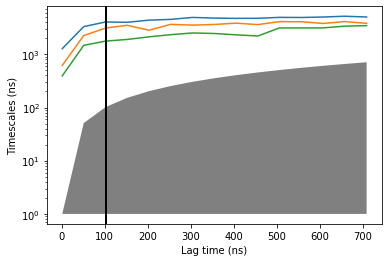

'\nreduction_type = "UMAP" \n\nreducer = dimreds[reduction_type](engen)\n\n#select the given number of components - best 3\nn_components = 3\nreducer.update_component_number(n_components)\n'

In [4]:
# Here you will perform dimensionality reduction 

# ------------------there are three options--------------------- #
# -------------------PCA, TICA or HDE----------------------------#
# --------- --uncomment the one you want to try------------------#

#Option 1 - PCA (not recommended)
'''
#chose PCA 
reduction_type = "PCA" 
reducer = dimreds[reduction_type](engen)
#choose the variance theshold you want to explain and pick number of components
var_thr = 95
reducer.plot_variance(var_thr)
plt.show()
n_components = reducer.get_variance(var_thr)
#select the given number of components
reducer.choose_n(n_components)
'''

#Option 2 - TICA 
'''
#chose TICA 
reduction_type = "TICA" 
#to make an informed decision on lag time range see the timescale of your simulation
traj_times = mdtraj.load(engen.traj, top=engen.ref).time
traj_nframes = len(traj_times)
lags = [int(np.log(i)) for i in np.logspace(1,  int(traj_nframes/50), num=15, base=np.e)]
#initialize TICA reducer
reducer = dimreds[reduction_type](engen, lags)
#estimate number of resolved processes and choose the lag time automatically
lag = reducer.choose_lag_auto()
if lag is None:
    reducer.plot_lag_analysis(chosen_lag=0)
    plt.show()
    lag = int(input("Please enter custom lag or run the cell again with different lags"))
print(lag)
reducer.choose_lag(lag)
#visualize TICA resolved process scales with different lags
reducer.plot_lag_analysis(chosen_lag=lag)
plt.show()
#choose variance threshold and number of components
var_thr = 96
n_components = reducer.get_variance(var_thr=var_thr)
reducer.plot_variance(var_thr=var_thr)
plt.show()
#select the corresponding number of components
reducer.choose_n(n_components)
'''

#Option 3 - HDE 


#choose HDE
reduction_type = "HDE" 
#find best lag range for your data
traj_times = mdtraj.load(engen.traj, top=engen.ref).time
traj_nframes = len(traj_times)
lags = [int(np.log(i)) for i in np.logspace(1, int(traj_nframes/50), num=15, base=np.e)]
#find best output dimensionality for your data
feat_dims = engen.featurizers[engen.chosen_feat_index].dimension()
# min(50, 10% of the feature dimensions)
#output_dims = min(50, int(feat_dims*0.5))
output_dims = 3
#initialize HDE reducer
reducer = dimreds[reduction_type](engen, lags, output_dims)
#estimate number of resolved processes and choose the lag time automatically
lag = reducer.choose_lag_auto()
#visualize HDE resolved process scales with different lags
reducer.plot_lag_analysis(chosen_lag=lag)
plt.show()


# Option 4 - UMAP
'''
reduction_type = "UMAP" 

reducer = dimreds[reduction_type](engen)

#select the given number of components - best 3
n_components = 3
reducer.update_component_number(n_components)
'''

### Step 2 - inspect the results visually

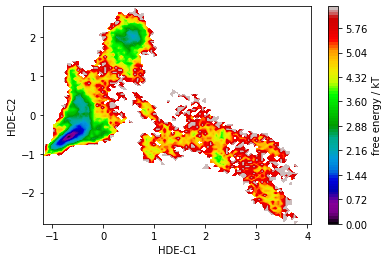

In [5]:
reducer.plot_2d()
plt.show()

In [6]:
reducer.plot_3d()

### Step 3 - save results for Workflow3 and clustering

In [7]:
# to apply the dimensionality reduction to the engen structure run:
reducer.apply()

# to save the results from this analysis for workflow3 run:
with open("wf2_resulting_EnGen_hde3.pickle", "wb") as file:
    pk.dump(engen, file, -1)

# Workflow 3 - cluster the trajectory

**Input:** EnGen object featurized with reduced dimensionality (generated by Workflow2)


**Output:** Representative trajectory ensemble  
<hr>
Steps:

1. Import the featurized trajectory from Workflow2
2. Choose clustering technique: KMeans, Gaussian Mixture Models
3. Choose appropriate parameters for clustering (number of clusters)
4. Additionally filter trajectories
5. Extract the ensemble

In [8]:
#required imports

from engens.core.EnGens import EnGen
from engens.core.ClustEn import *
import pickle as pk

### Step 0 - Load data from Workflow2

In [34]:
engen = None
with open("wf2_resulting_EnGen_hde3.pickle", "rb") as file:
    engen = pk.load(file)

In [35]:
traj = engen.traj
ref = engen.ref
print("Using the trajectory {} and reference pdb file {}".format(traj, ref))

topology = engen.mdtrajref
print("The topology is:")
print(topology)

feat_dims = engen.dimred_data.shape[0]
print("The dimensionality of your featurization is {}".format(feat_dims))

feat = engen.featurizers[engen.chosen_feat_index]

dimred_data = engen.dimred_data
print("After dimensionality reduction the dimension of your features is {}".format(dimred_data.shape[1]))


Using the trajectory ./data/md_combined-1.xtc and reference pdb file ./data/npt_out.pdb
The topology is:
<mdtraj.Topology with 1 chains, 1345 residues, 22164 atoms, 22332 bonds>
The dimensionality of your featurization is 35471
After dimensionality reduction the dimension of your features is 3


In [59]:
#------------two clustering algorithms------------------#
#----------------choose and uncomment one----------------#
# Option 1 - choose Kmeans
'''
clustering = "KM"
cluster_method = clusterings[clustering](engen, n_rep=2)
'''

# Option 2 - choose GMMs

clustering = "GMM" 
cluster_method = clusterings[clustering](engen, n_rep=2)


Clustering with params={'n_components': 2}
Clustering with params={'n_components': 3}
Clustering with params={'n_components': 4}
Clustering with params={'n_components': 5}
Clustering with params={'n_components': 6}
Clustering with params={'n_components': 7}
Clustering with params={'n_components': 8}
Clustering with params={'n_components': 9}


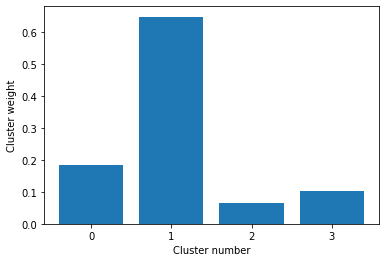

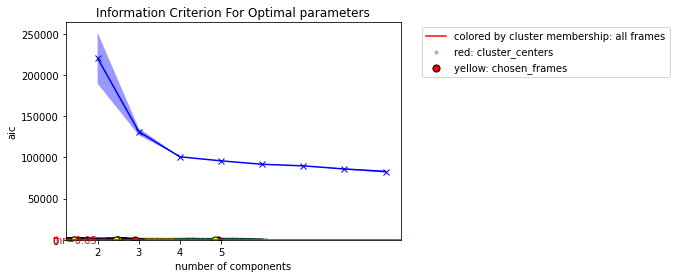

Optimal params={'n_components': 4}


In [60]:
# Create K clusters
if clustering =="KM":
    params = [{"n_clusters":i} for i in range(2, 10)]
    cluster_method.cluster_multiple_params(params)
else:
    params = [{"n_components":i} for i in range(2, 10)]
    cluster_method.cluster_multiple_params(params)

# analyze these parameters with the elbow method
cluster_method.analyze_elbow_method()

In [61]:

plt.ion() 
# analyze these parameters with the silhouette method
cluster_method.analyze_silhouette()



ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.6/site-packages/IPython/core/interactiveshell.py", line 3343, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-61-c7c2212092f4>", line 3, in <module>
    cluster_method.analyze_silhouette()
  File "/usr/local/lib/python3.6/site-packages/engens/core/ClustEn.py", line 269, in analyze_silhouette
    avg_sil.append(self.plot_silhouette(n_clusters, cluster_labels, X, cluster_centers))
  File "/usr/local/lib/python3.6/site-packages/engens/core/ClustEn.py", line 193, in plot_silhouette
    silhouette_avg = silhouette_score(X, cluster_labels)
  File "/usr/local/lib/python3.6/site-packages/sklearn/utils/validation.py", line 63, in inner_f
    return f(*args, **kwargs)
  File "/usr/local/lib/python3.6/site-packages/sklearn/metrics/cluster/_unsupervised.py", line 117, in silhouette_score
    return np.mean(silhouette_samples(X, labels, metric=metric, **kwds))
  File "/usr/local/lib/python3.6/

TypeError: object of type 'NoneType' has no len()

Error in callback <function flush_figures at 0x7fb37f509840> (for post_execute):


KeyboardInterrupt: 

In [62]:
# pick the number of clusters
n = 3
cluster_method.choose_n(n)

### Step 3 - optionally pick a subset of clusters with the heighest weight

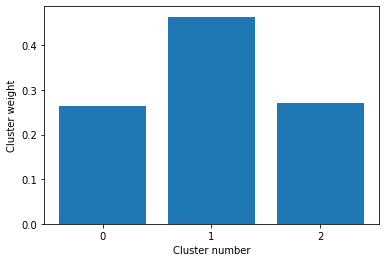

In [63]:
cluster_method.plot_cluster_weight()

Chosen cluster ids: [0, 1, 2]


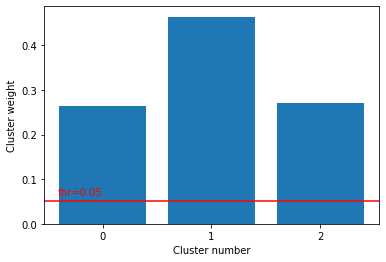

In [64]:
cluster_method.choose_clusters(thr=0.05)

### Step 4 - extract conformations for the ensemble

0
1
2
Closest conformation inside cluster 0 frame 7080 of the striped trajectory
Extracting and saving to ./res_ensemble/conf_in_cluster_0.pdb
File with the same name exists
Deleting the old file
Closest conformation inside cluster 1 frame 12977 of the striped trajectory
Extracting and saving to ./res_ensemble/conf_in_cluster_1.pdb
File with the same name exists
Deleting the old file
Closest conformation inside cluster 2 frame 22362 of the striped trajectory
Extracting and saving to ./res_ensemble/conf_in_cluster_2.pdb
File with the same name exists
Deleting the old file


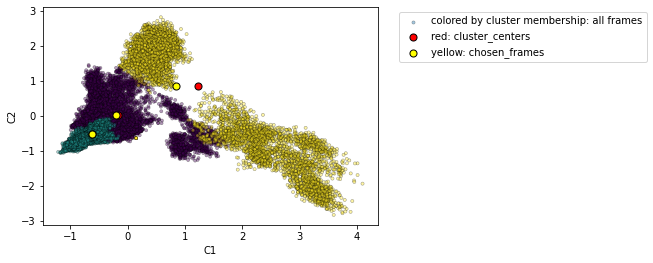

In [65]:
ensemble_location = "./res_ensemble"
cluster_method.choose_conformations()
cluster_method.extract_conformations(ensemble_location)


### Step 5 - save results for analysis

In [66]:
cluster_method

In [67]:
with open("wf3_resulting_EnGen_hde3gmm.pickle", "wb") as file:
    pk.dump(engen, file, -1)
    
with open("wf3_resulting_Clust_hde3gmm.pickle", "wb") as file:
    pk.dump(cluster_method, file, -1)

# Workflow 4 - analyze the results
<hr>

1. Cluster interactive plots
2. Movie trajectory plots

In [68]:
#required imports
from ipywidgets import interact, interactive, fixed, interact_manual
from ipywidgets import interactive, fixed, IntSlider, VBox, HBox, Layout
import ipywidgets as widgets
import matplotlib.patheffects as PathEffects
from IPython.display import display,clear_output
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from engens.core.EnGens import EnGen
from engens.core.ClustEn import *
from engens.core.FeatureSelector import *
from engens.core.DimReduction import *
from engens.core.PlotUtils import *
import pickle as pk
import os

In [69]:
plt.ioff()

In [70]:
engen = None
with open("wf3_resulting_EnGen_hde3gmm.pickle", "rb") as file:
    engen = pk.load(file)
clust = None
with open("wf3_resulting_Clust_hde3gmm.pickle", "rb") as file:
    clust = pk.load(file)

In [71]:
engen

In [88]:
p_utils1 = PlotUtils(engen, clust, stride=50, file_loc="./")
# if your trajectory is very large plotting this dashboard migth take some time
# because one point for every frame has to be plotted
# if you want a faster plot - provide the stride - run:
# p_utils1 = PlotUtils(engen, clust, stride=20)
# this will load every 20th frame from the trajectory
p_utils1.dashboard1(path = "./res_ensemble", fileloc=None)

There is a mismatch between the number of PDB files in the directory
 you provided and the number of selected conformations.
Structures will not be displayed.
Make sure you provide the directory you provide 
 contains only EnGens generated conformations.


In [85]:
timeline_fig = p_utils1.view_timeline(width=1000)

In [89]:
pcs_fig =p_utils1.view_PCs(fileloc=None)

In [86]:
timeline_fig.write_image("res_plots/timeline.pdf")

In [90]:
pcs_fig.write_image("res_plots/PCs.pdf")

In [46]:
p_utils1.view_movie()

NGLWidget(max_frame=35470)

## Some distances

In [73]:
# to avoid loading the full array into memory
def load_as_memmap(pyemma_source):
    pyemma_data_dimension = pyemma_source.dimension()
    pyemma_data_n_frames = pyemma_source.n_frames_total()
    pyemma_iter = pyemma_source.iterator()
    # initialize array
    data_memmap = np.memmap('tmp_data.mymemmap', 
                            dtype='float32', 
                            mode='w+', 
                            shape=(pyemma_data_n_frames,pyemma_data_dimension))
    shape_cnt = 0
    for i, elem in tqdm.tqdm(enumerate(pyemma_iter),total = pyemma_source.n_chunks(pyemma_source.chunksize)):
        data = elem[1]
        data_memmap[shape_cnt : shape_cnt+data.shape[0], :] = data
        shape_cnt += data.shape[0]

    if not shape_cnt == pyemma_data_n_frames:
        print("Warning: output data dimensions don't match the number of frames")
    
    return data_memmap

In [74]:

from pyemma.coordinates import source

def extract_interesting_contacts(traj, top, indices, chunksize):
    
    pyemma_src = source(traj, top=top, chunksize=chunksize)
    pyemma_src.featurizer.add_contacts(indices)
    
    data = load_as_memmap(pyemma_src)
    return data

In [75]:
def extract_interesting_distances(traj, top, indices, chunksize):
    
    pyemma_src = source(traj, top=top, chunksize=chunksize)
    pyemma_src.featurizer.add_residue_mindist(indices)
    
    data = load_as_memmap(pyemma_src)
    return data

In [76]:
def extract_group_distances(traj, top, chunksize):
    
    feat = pyemma.coordinates.featurizer(top) 
    # group nSH2 1322-1430
    # group helical 337-678
    # group iSH2 1440-1587
    group_nSH2 = feat.select('residue > 1322 and residue < 1430')
    group_helical =  feat.select('residue > 337 and residue < 678')
    group_iSH2 =  feat.select('residue > 1440 and residue < 1587')
    groups_list = [group_nSH2,group_helical, group_iSH2]

    pyemma_src = source(traj, top=top, chunksize=chunksize)
    pyemma_src.featurizer.add_group_COM(group_definitions=[group_nSH2, group_helical])
    
    data = load_as_memmap(pyemma_src)
    return data

In [77]:
#### import plotly.graph_objects as go
import numpy as np
from matplotlib import cm

def plot_custom_feature_box(clust, feature, y_title="feature"):
    
    n_clusters = clust.chosen_index + 2
    
    colors = cm.viridis(np.linspace(0, n_clusters, n_clusters)/(n_clusters))
    
    y_list = []
    for i in range(n_clusters):
        y = feature[np.argwhere(clust.labels[clust.chosen_index]==i).flatten()]
        y_list.append(y)

    fig = go.Figure()
    for i, y in enumerate(y_list):
        fig.add_trace(go.Box(y=y, marker={"color":mc.rgb2hex(colors[i])}, name="Cluster #{}".format(i)))
        
    fig.update_layout(yaxis_title=y_title)
    fig.show()
    return fig

In [78]:
#### import plotly.graph_objects as go
import numpy as np
from matplotlib import cm

def plot_custom_feature_scatter(clust, feature, y_title="feature"):
    
    n_clusters = clust.chosen_index + 2
    
    colors = cm.viridis(np.linspace(0, n_clusters, n_clusters)/(n_clusters))
    
    y_list = []
    x_list = []
    for i in range(n_clusters):
        y = feature[np.argwhere(clust.labels[clust.chosen_index]==i).flatten()]
        y_list.append(y)
        x_list.append(np.argwhere(clust.labels[clust.chosen_index]==i).flatten())
    
    print(x_list)
    print(y_list)
    fig = go.Figure()
    for i, y in enumerate(y_list):
        fig.add_trace(go.Scatter(x = x_list[i], y=y, 
        mode='markers', marker={"color":mc.rgb2hex(colors[i])}, 
                                                             name="Cluster #{}".format(i)))
        
    fig.update_layout(yaxis_title=y_title)
    fig.show()
    return fig

### Lys545-Asp421 distances plots

In [102]:
data = extract_interesting_distances(engen.traj, engen.ref, [[544, 1167]], 500)

100%|██████████| 71/71 [00:38<00:00,  1.84it/s]


In [92]:
fig_scatter = plot_custom_feature_scatter(clust, data[:, 0].flatten())

[array([    2,   410,   469, ..., 29351, 29352, 29353]), array([    1,     3,     4, ..., 35468, 35469, 35470]), array([    0,  6943,  7434, ..., 25077, 25078, 29603])]
[array([0.50605315, 1.0015836 , 1.0616304 , ..., 1.4045163 , 1.60308   ,
       1.5506972 ], dtype=float32), array([0.60637975, 0.5694372 , 0.66812396, ..., 1.3922838 , 1.3925529 ,
       1.3965721 ], dtype=float32), array([0.76368237, 0.76368237, 1.8718781 , ..., 2.7933624 , 0.76368237,
       0.76368237], dtype=float32)]


In [93]:
fig_scatter.write_image("res_plots/lys_asp_scatter.pdf")

In [103]:
fig_box = plot_custom_feature_box(clust, data[:, 0].flatten())

In [104]:
fig_box.write_image("res_plots/lys_asp_box.pdf")

### Lys 545- Lys xxx distances

In [95]:
data = extract_interesting_distances(engen.traj, engen.ref, [[544, 1167-42]], 500)

100%|██████████| 71/71 [00:38<00:00,  1.83it/s]


In [96]:
fig_scatter = plot_custom_feature_scatter(clust, data[:, 0].flatten())

[array([    2,   410,   469, ..., 29351, 29352, 29353]), array([    1,     3,     4, ..., 35468, 35469, 35470]), array([    0,  6943,  7434, ..., 25077, 25078, 29603])]
[array([0.40726152, 0.6225177 , 0.65545684, ..., 0.6200452 , 0.6199044 ,
       0.65942824], dtype=float32), array([0.45230606, 0.3887377 , 0.42333212, ..., 0.6919745 , 0.6585969 ,
       0.6510938 ], dtype=float32), array([0.3847401, 0.3847401, 1.2270333, ..., 3.3561058, 0.3847401,
       0.3847401], dtype=float32)]


In [98]:
fig_scatter.write_image("res_plots/lys_lys_scatter.pdf")

In [99]:
fig_box = plot_custom_feature_box(clust, data[:, 0].flatten())

In [101]:
fig_box.write_image("res_plots/lys_lys_box.pdf")

### nSH2-helical distances plots

In [105]:
data = extract_group_distances(engen.traj, engen.ref, 500)

100%|██████████| 71/71 [00:52<00:00,  1.36it/s]


In [106]:
data_com_dist =np.sqrt(np.power((data[:, 0]-data[:, 3]), 2) + 
        np.power((data[:, 0+1]-data[:, 3+1]), 2) + 
        np.power((data[:, 0+2]-data[:, 3]+2), 2))

In [107]:
fig_scatter = plot_custom_feature_scatter(clust, data_com_dist)

[array([    2,   410,   469, ..., 29351, 29352, 29353]), array([    1,     3,     4, ..., 35468, 35469, 35470]), array([    0,  6943,  7434, ..., 25077, 25078, 29603])]
[array([7.489248 , 7.7578435, 7.8406987, ..., 7.5597105, 7.545353 ,
       7.5776033], dtype=float32), array([7.421636 , 7.4435115, 7.458101 , ..., 7.491015 , 7.4956083,
       7.4892564], dtype=float32), array([7.386385, 7.386385, 8.32762 , ..., 8.524242, 7.386385, 7.386385],
      dtype=float32)]


In [108]:
fig_scatter.write_image("res_plots/nSH2-h-dist_scatter.pdf")

In [109]:
fig_box = plot_custom_feature_box(clust, data_com_dist)

In [110]:
fig_box.write_image("res_plots/nSH2-h-dist_box.pdf")